In [ ]:
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader, random_split
from segmentation_models_pytorch.losses import DiceLoss
from segmentation_models_pytorch.metrics.functional import get_stats, iou_score
from tqdm import tqdm
import numpy as np
import seaborn as sns

from dataset import SatelliteImageDataset
from res_unet_a import ResUNetA
from utils import (
    one_hot_to_image,
    plot_prediction,
    compute_accuracy,
    class_index_to_one_hot,
    class_index_to_image,
    get_color_patches,
    print_iou,
    get_iou_by_class
)

torch.manual_seed(40)

In [116]:
dataset = SatelliteImageDataset(
    image_dir='data/images',
    mask_dir='data/masks'
)

In [117]:
train_set, test_set = random_split(dataset, [0.8, 0.2])

In [118]:
img, mask = dataset[0]

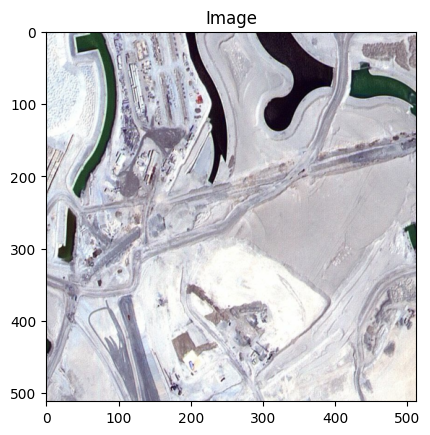

In [119]:
plt.imshow(img.permute(1, 2, 0))
plt.title('Image')
plt.show()

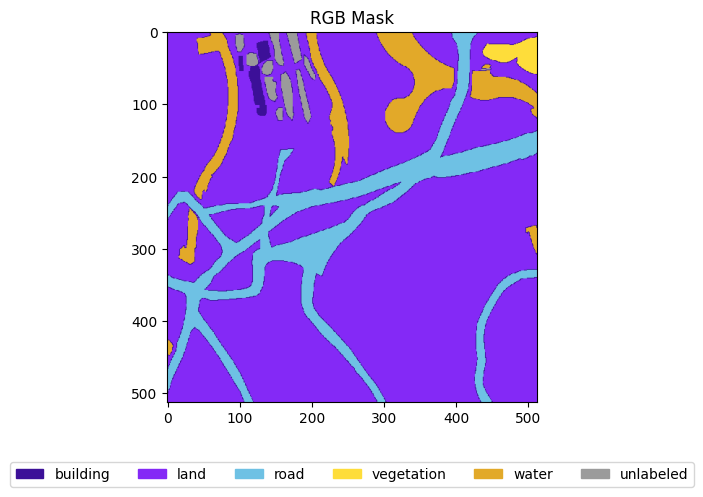

In [120]:
mask_rgb = class_index_to_image(torch.unsqueeze(mask, 0), dataset.color_map)[0]
plt.imshow(mask_rgb.permute(1, 2, 0))

patches = get_color_patches(dataset.color_map, dataset.mask_labels)
plt.legend(handles=patches, loc='lower center', bbox_to_anchor=(0.5, -0.25), fontsize=10, ncol=6)

plt.title('RGB Mask')
plt.show()

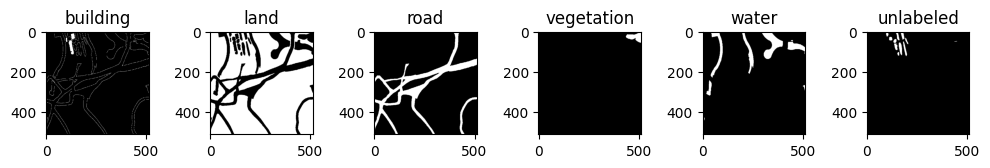

In [121]:
fig, axes = plt.subplots(1, 6, figsize=(10, 8))
mask = class_index_to_one_hot(mask, dataset.color_map)

for i in range(6):
    axes[i].imshow(mask[i], cmap='gray')
    axes[i].set_title(dataset.mask_labels[i])

plt.tight_layout()
plt.show()

In [9]:
train_loader = DataLoader(train_set, shuffle=True)
test_loader = DataLoader(test_set)

In [10]:
LEARNING_RATE = 3e-4
EPOCHS = 50

In [11]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model = ResUNetA(in_channels=3, out_channels=6).to(device)

In [12]:
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)
criterion = DiceLoss('multiclass').to(device)

Epoch 1:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.74it/s]


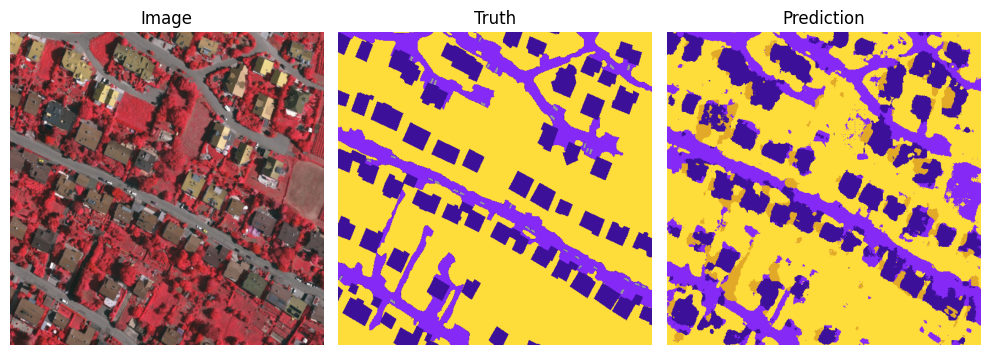

Accuracy: 0.4491 | Loss: 0.5054


Epoch 2:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.5434 | Loss: 0.4361


Epoch 3:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.5707 | Loss: 0.4119


Epoch 4:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.5757 | Loss: 0.3976


Epoch 5:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.6084 | Loss: 0.3735


Epoch 6:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.76it/s]


Accuracy: 0.6289 | Loss: 0.3580


Epoch 7:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.6512 | Loss: 0.3451


Epoch 8:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


Accuracy: 0.6764 | Loss: 0.3348


Epoch 9:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.76it/s]


Accuracy: 0.6814 | Loss: 0.3325


Epoch 10:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


Accuracy: 0.7176 | Loss: 0.3155


Epoch 11:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


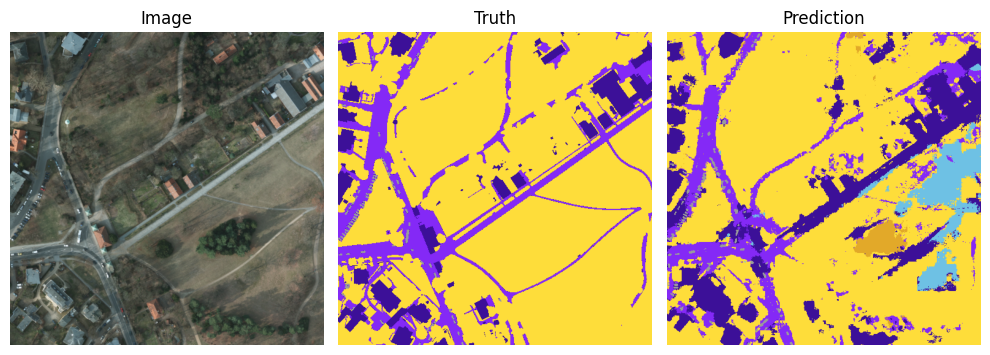

Accuracy: 0.7304 | Loss: 0.3112


Epoch 12:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.7447 | Loss: 0.3023


Epoch 13:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


Accuracy: 0.7451 | Loss: 0.3011


Epoch 14:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


Accuracy: 0.7599 | Loss: 0.2921


Epoch 15:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.7748 | Loss: 0.2830


Epoch 16:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.7786 | Loss: 0.2795


Epoch 17:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.7791 | Loss: 0.2785


Epoch 18:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


Accuracy: 0.7832 | Loss: 0.2720


Epoch 19:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.7832 | Loss: 0.2737


Epoch 20:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.8000 | Loss: 0.2671


Epoch 21:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.73it/s]


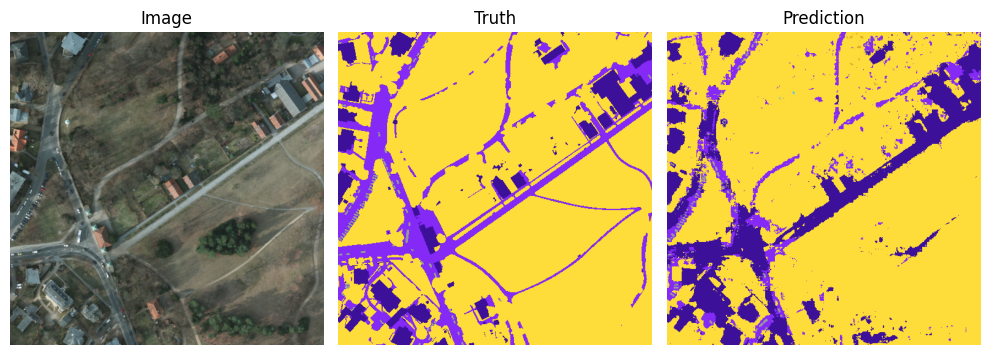

Accuracy: 0.8013 | Loss: 0.2616


Epoch 22:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.73it/s]


Accuracy: 0.8071 | Loss: 0.2589


Epoch 23:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.74it/s]


Accuracy: 0.7951 | Loss: 0.2657


Epoch 24:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


Accuracy: 0.8113 | Loss: 0.2549


Epoch 25:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.8132 | Loss: 0.2521


Epoch 26:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.8185 | Loss: 0.2460


Epoch 27:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


Accuracy: 0.8271 | Loss: 0.2397


Epoch 28:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.74it/s]


Accuracy: 0.8212 | Loss: 0.2438


Epoch 29:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.74it/s]


Accuracy: 0.8258 | Loss: 0.2371


Epoch 30:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


Accuracy: 0.8236 | Loss: 0.2392


Epoch 31:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


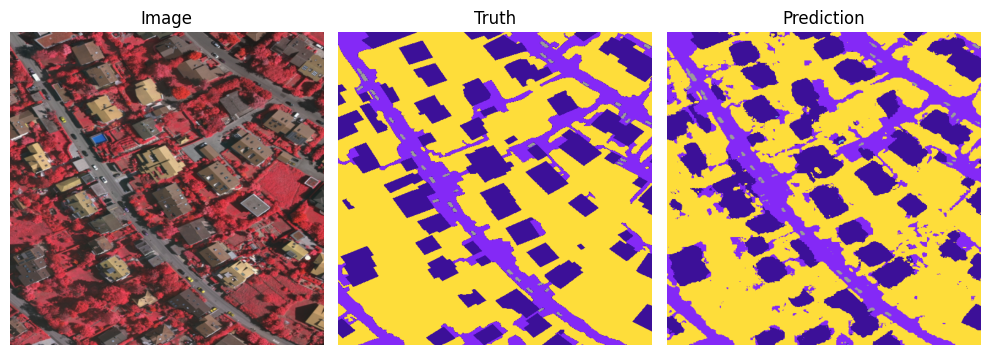

Accuracy: 0.8305 | Loss: 0.2327


Epoch 32:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


Accuracy: 0.8336 | Loss: 0.2294


Epoch 33:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.74it/s]


Accuracy: 0.8347 | Loss: 0.2277


Epoch 34:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.74it/s]


Accuracy: 0.8363 | Loss: 0.2234


Epoch 35:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.74it/s]


Accuracy: 0.8372 | Loss: 0.2244


Epoch 36:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


Accuracy: 0.8353 | Loss: 0.2240


Epoch 37:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


Accuracy: 0.8362 | Loss: 0.2238


Epoch 38:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


Accuracy: 0.8462 | Loss: 0.2134


Epoch 39:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.76it/s]


Accuracy: 0.8482 | Loss: 0.2105


Epoch 40:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.76it/s]


Accuracy: 0.8447 | Loss: 0.2126


Epoch 41:


Training: 100%|██████████| 163/163 [00:59<00:00,  2.75it/s]


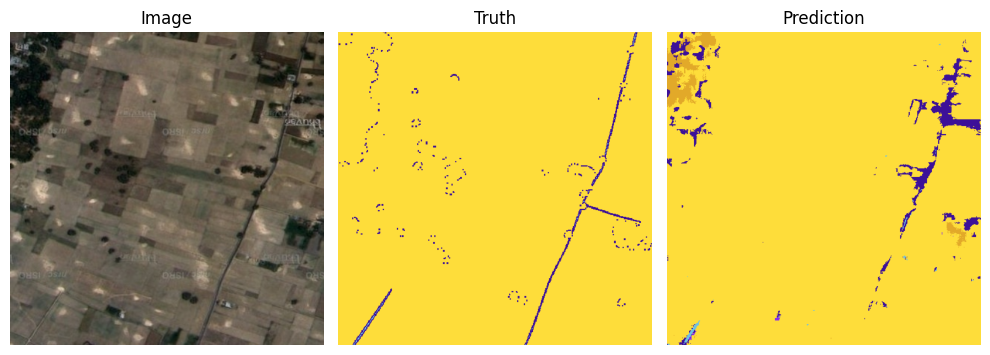

Accuracy: 0.8493 | Loss: 0.2066


Epoch 42:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.77it/s]


Accuracy: 0.8460 | Loss: 0.2113


Epoch 43:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.77it/s]


Accuracy: 0.8525 | Loss: 0.2038


Epoch 44:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.78it/s]


Accuracy: 0.8579 | Loss: 0.1986


Epoch 45:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.77it/s]


Accuracy: 0.8590 | Loss: 0.1958


Epoch 46:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.78it/s]


Accuracy: 0.8567 | Loss: 0.1997


Epoch 47:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.77it/s]


Accuracy: 0.8545 | Loss: 0.2005


Epoch 48:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.78it/s]


Accuracy: 0.8494 | Loss: 0.2073


Epoch 49:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.77it/s]


Accuracy: 0.8567 | Loss: 0.1967


Epoch 50:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.78it/s]

Accuracy: 0.8580 | Loss: 0.1944




In [13]:
loss_list = []
acc_list = []

for epoch in range(EPOCHS):
    print(f'Epoch {epoch + 1}:')

    model.train()
    running_loss = 0
    running_acc = 0

    for x, y in tqdm(train_loader, desc='Training', colour='#00FF00'):
        x, y = x.to(device), y.to(device) # y: (b, h, w)
        y_pred = model(x) # y_pred: (b, 6, h, w)

        loss = criterion(y_pred, y)
        running_loss += loss.item()

        # compute the accuracy of the prediction
        running_acc += compute_accuracy(y, y_pred, device)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    if epoch % 10 == 0:
        # show first image in the last batch with matplotlib
        y_imgs = class_index_to_image(y, dataset.color_map, device)
        pred_imgs = one_hot_to_image(y_pred, dataset.color_map, device)
        plot_prediction(x, y_imgs, pred_imgs, dataset.color_map, dataset.mask_labels)

    epoch_acc = running_acc / len(train_loader)
    epoch_loss = running_loss / len(train_loader)
    acc_list.append(epoch_acc)
    loss_list.append(epoch_loss)

    print(f'Accuracy: {epoch_acc:.4f} | Loss: {epoch_loss:.4f}')
    print('\n')


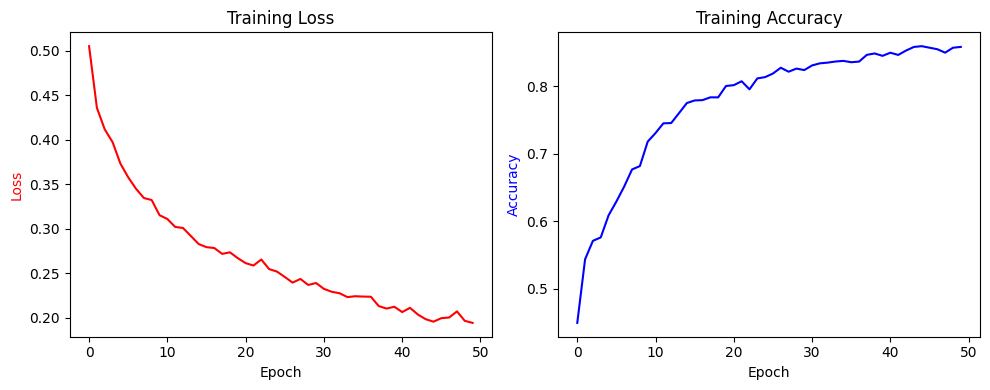

In [123]:
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
axes[0].plot(loss_list, color='red')
axes[0].set_ylabel('Loss', color='red')
axes[0].set_xlabel('Epoch')
axes[0].set_title('Training Loss')

axes[1].plot(acc_list, color='blue')
axes[1].set_ylabel('Accuracy', color='blue')
axes[1].set_xlabel('Epoch')
axes[1].set_title('Training Accuracy')

plt.tight_layout()
plt.show()

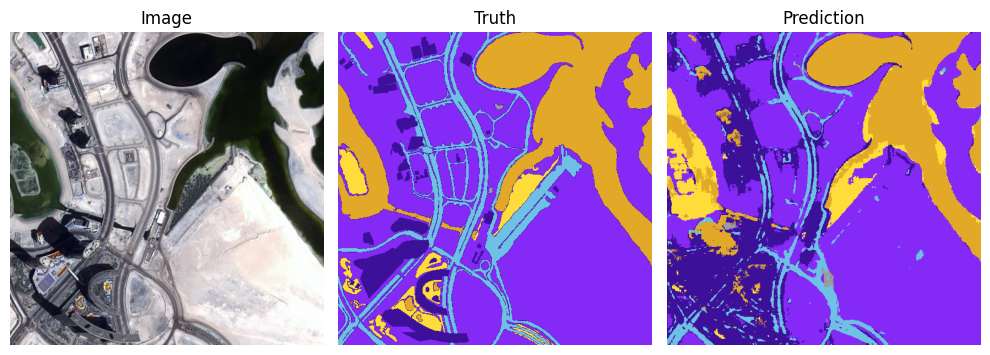

Accuracy: 0.7329 | Loss: 0.5011
IOU... building: 0.30 land: 0.73 road: 0.38 vegetation: 0.18 water: 0.71 




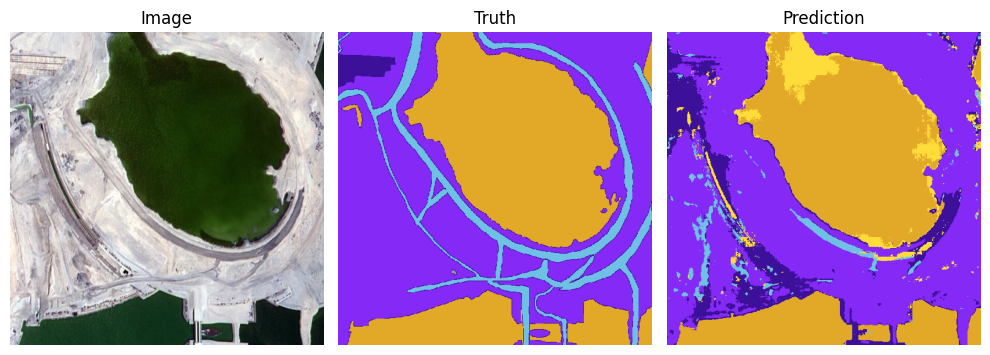

Accuracy: 0.7590 | Loss: 0.4805
IOU... building: 0.12 land: 0.69 road: 0.08 water: 0.88 




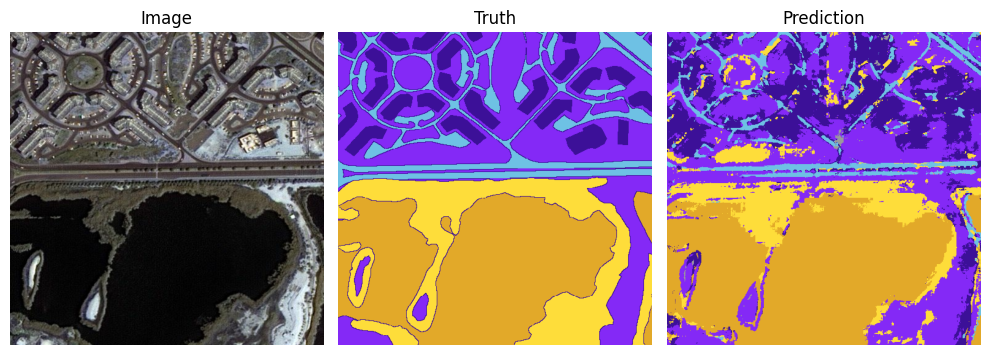

Accuracy: 0.6519 | Loss: 0.3311
IOU... building: 0.29 land: 0.41 road: 0.36 vegetation: 0.36 water: 0.87 




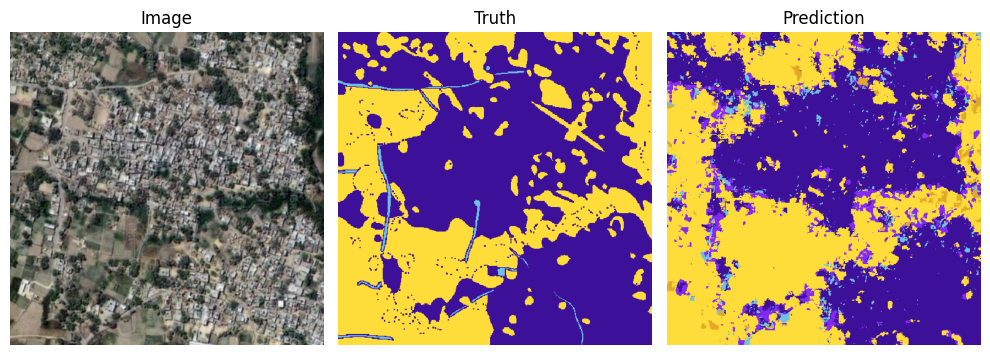

Accuracy: 0.7428 | Loss: 0.2383
IOU... building: 0.67 road: 0.00 vegetation: 0.62 




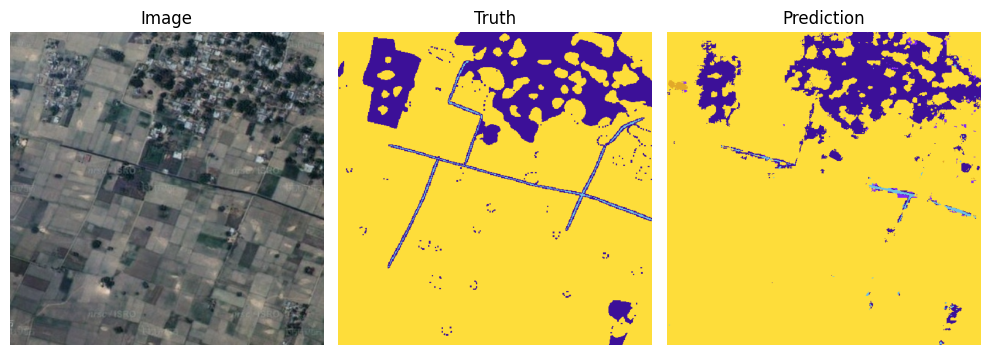

Accuracy: 0.9144 | Loss: 0.1717
IOU... building: 0.58 road: 0.17 vegetation: 0.91 




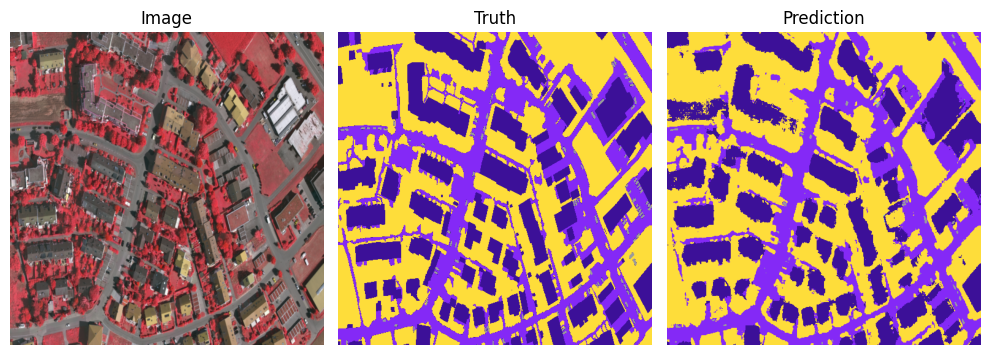

Accuracy: 0.8651 | Loss: 0.1741
IOU... building: 0.71 land: 0.72 vegetation: 0.83 water: 1.00 unlabeled: 0.24 




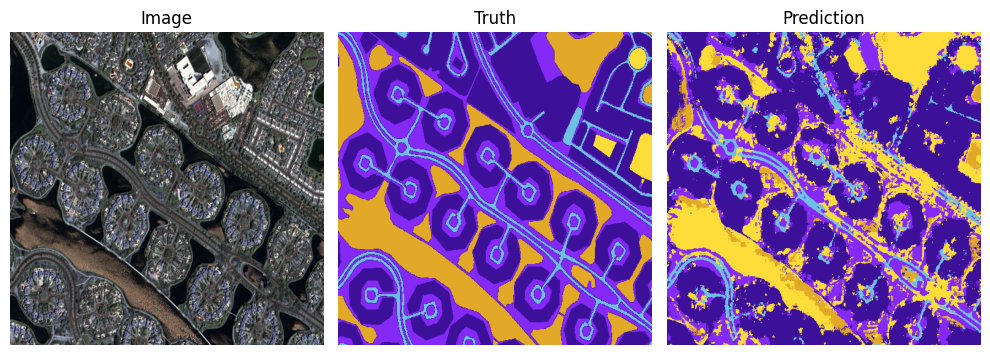

Accuracy: 0.5386 | Loss: 0.4751
IOU... building: 0.62 land: 0.32 road: 0.42 vegetation: 0.03 water: 0.15 




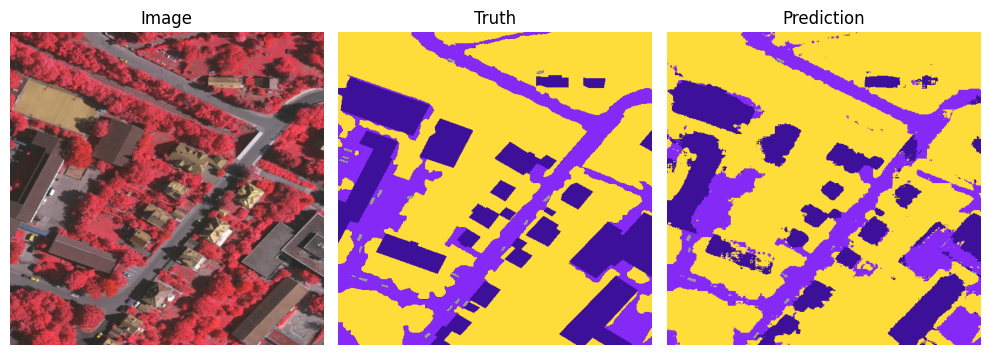

Accuracy: 0.8784 | Loss: 0.1700
IOU... building: 0.66 land: 0.63 vegetation: 0.88 water: 1.00 unlabeled: 0.31 




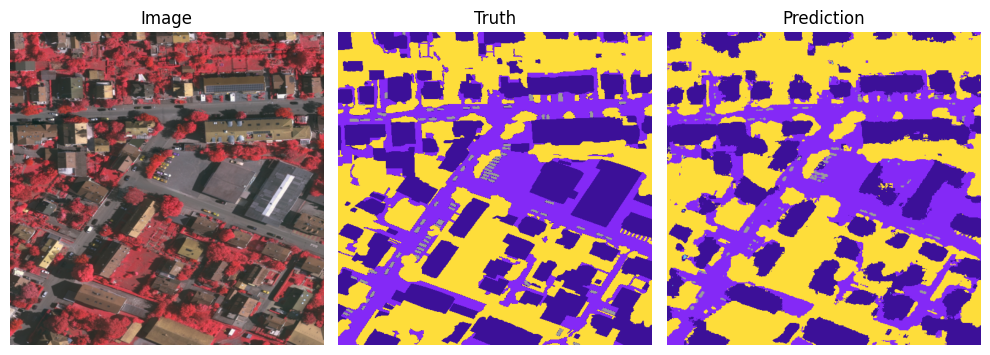

Accuracy: 0.8468 | Loss: 0.1597
IOU... building: 0.69 land: 0.64 vegetation: 0.85 water: 1.00 unlabeled: 0.36 




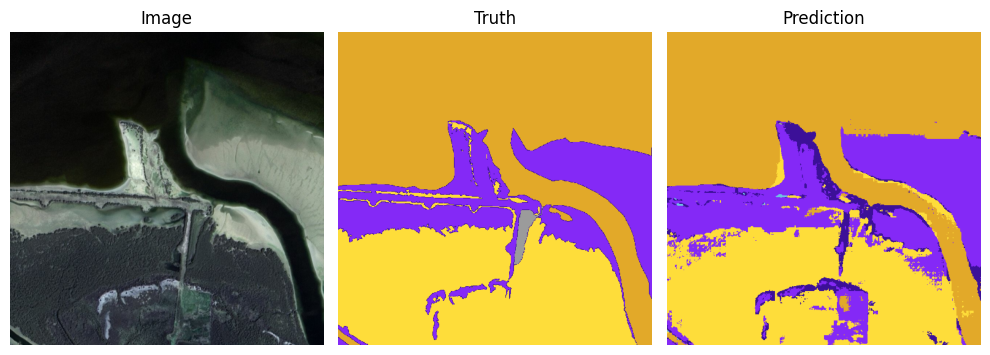

Accuracy: 0.8868 | Loss: 0.3543
IOU... building: 0.12 land: 0.68 vegetation: 0.80 water: 0.94 




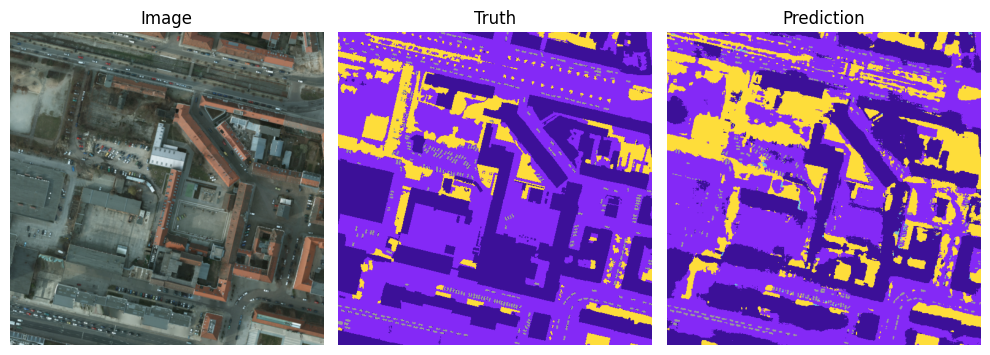

Accuracy: 0.7495 | Loss: 0.1932
IOU... building: 0.62 land: 0.64 vegetation: 0.48 water: 1.00 unlabeled: 0.48 




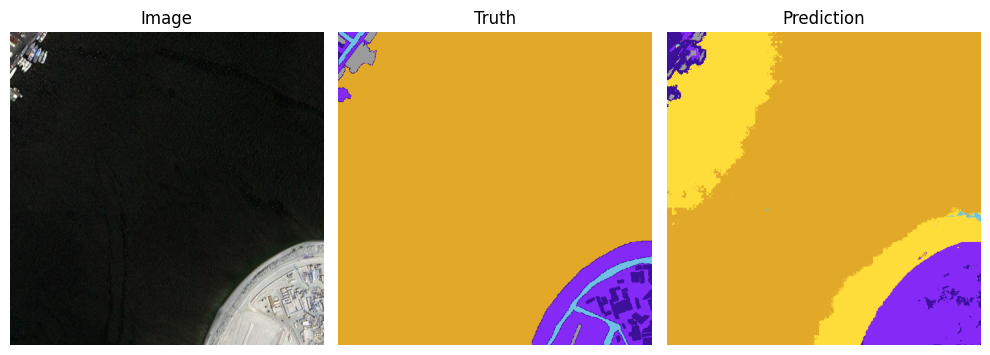

Accuracy: 0.7566 | Loss: 0.4468
IOU... building: 0.15 land: 0.63 road: 0.00 water: 0.77 unlabeled: 0.25 




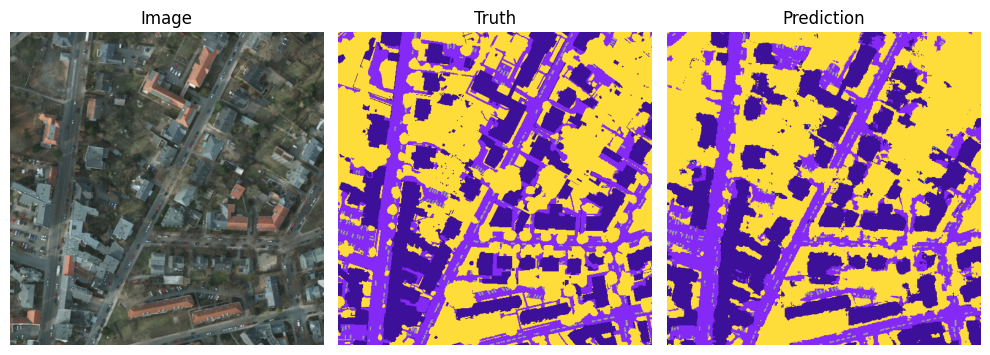

Accuracy: 0.8243 | Loss: 0.1431
IOU... building: 0.71 land: 0.58 vegetation: 0.77 water: 1.00 unlabeled: 0.55 




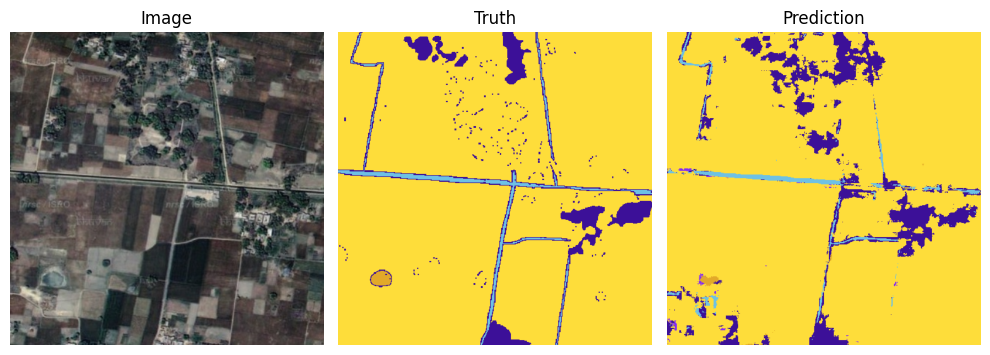

Accuracy: 0.9167 | Loss: 0.2289
IOU... building: 0.34 road: 0.40 vegetation: 0.92 water: 0.44 




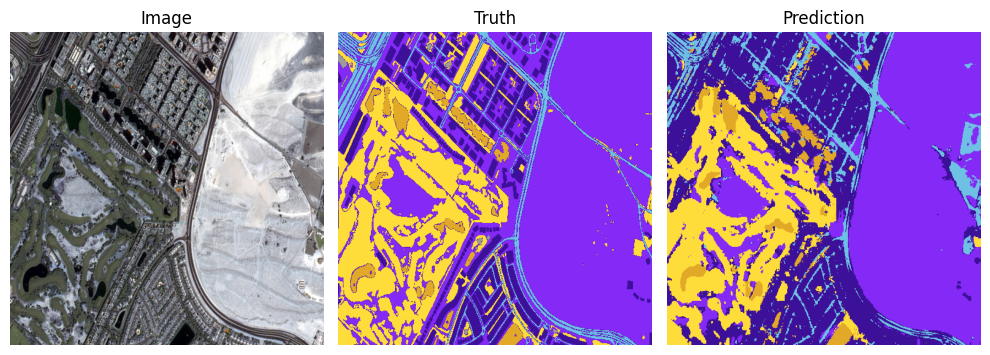

Accuracy: 0.7251 | Loss: 0.4312
IOU... building: 0.39 land: 0.68 road: 0.36 vegetation: 0.66 water: 0.59 




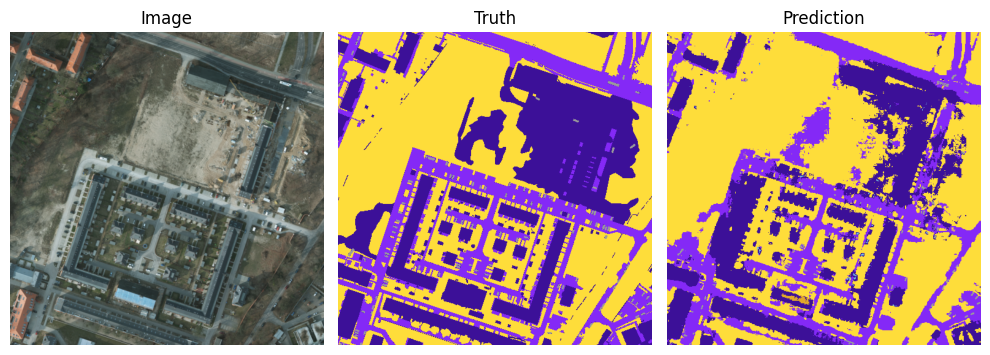

Accuracy: 0.7713 | Loss: 0.2101
IOU... building: 0.50 land: 0.52 vegetation: 0.76 unlabeled: 0.37 




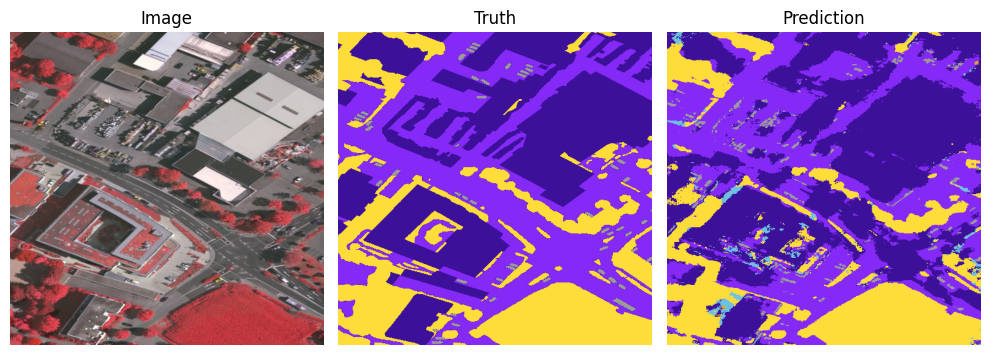

Accuracy: 0.7449 | Loss: 0.2275
IOU... building: 0.55 land: 0.60 vegetation: 0.73 unlabeled: 0.20 




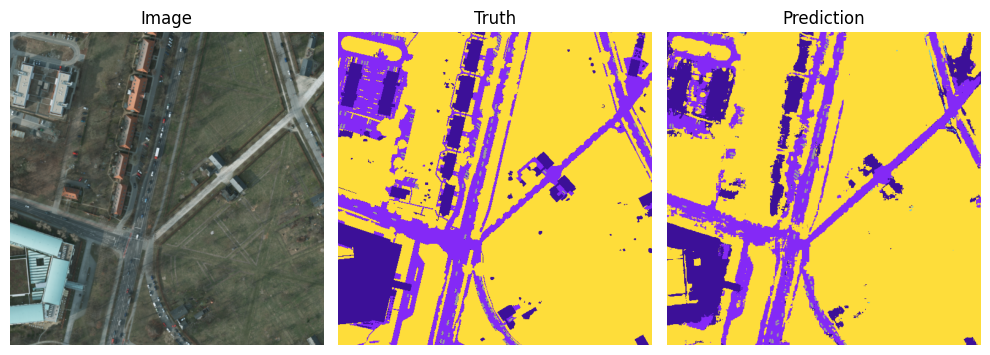

Accuracy: 0.8814 | Loss: 0.1468
IOU... building: 0.57 land: 0.62 vegetation: 0.88 unlabeled: 0.53 




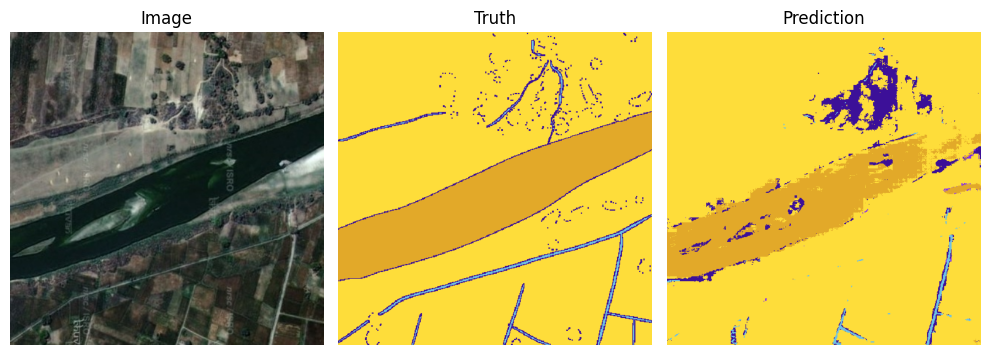

Accuracy: 0.8865 | Loss: 0.2790
IOU... building: 0.11 road: 0.20 vegetation: 0.88 water: 0.74 unlabeled: 1.00 




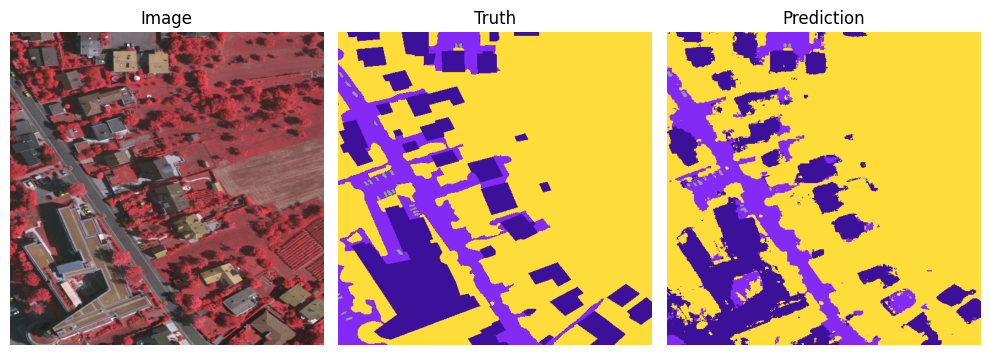

Accuracy: 0.8772 | Loss: 0.1890
IOU... building: 0.65 land: 0.53 vegetation: 0.88 unlabeled: 0.29 




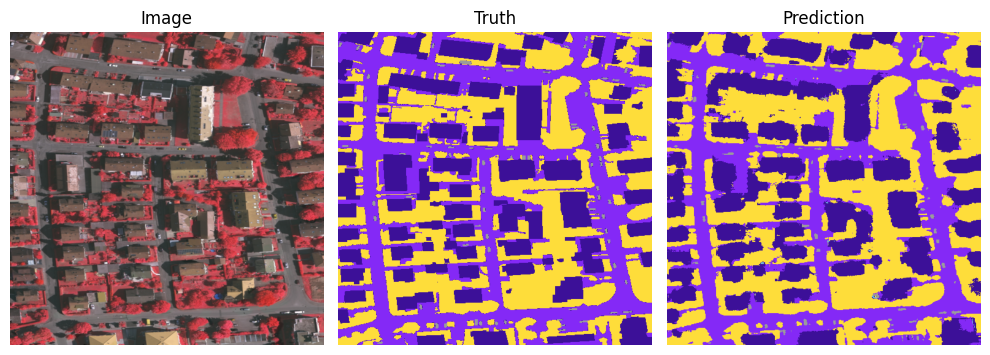

Accuracy: 0.8438 | Loss: 0.1500
IOU... building: 0.70 land: 0.69 vegetation: 0.79 water: 1.00 unlabeled: 0.40 




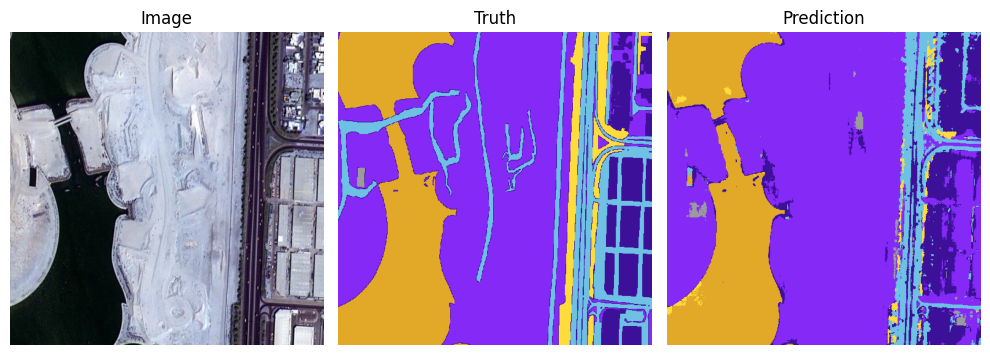

Accuracy: 0.7697 | Loss: 0.4884
IOU... building: 0.34 land: 0.75 road: 0.28 vegetation: 0.18 water: 0.96 




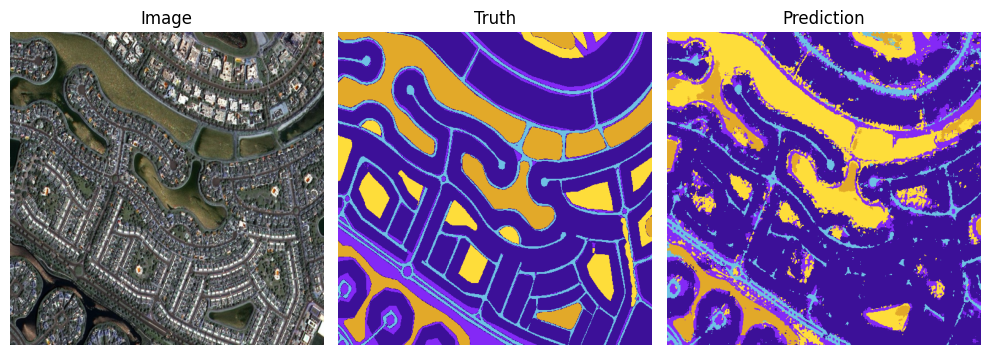

Accuracy: 0.6473 | Loss: 0.4414
IOU... building: 0.74 land: 0.22 road: 0.33 vegetation: 0.11 water: 0.29 




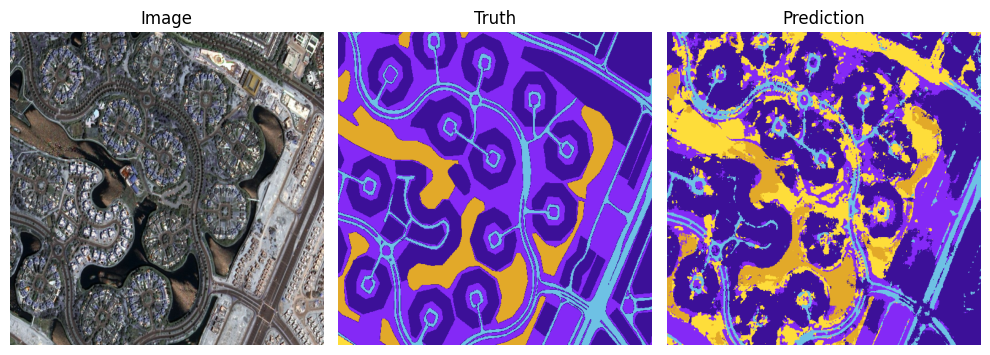

Accuracy: 0.6096 | Loss: 0.3913
IOU... building: 0.60 land: 0.37 road: 0.49 vegetation: 0.00 water: 0.55 




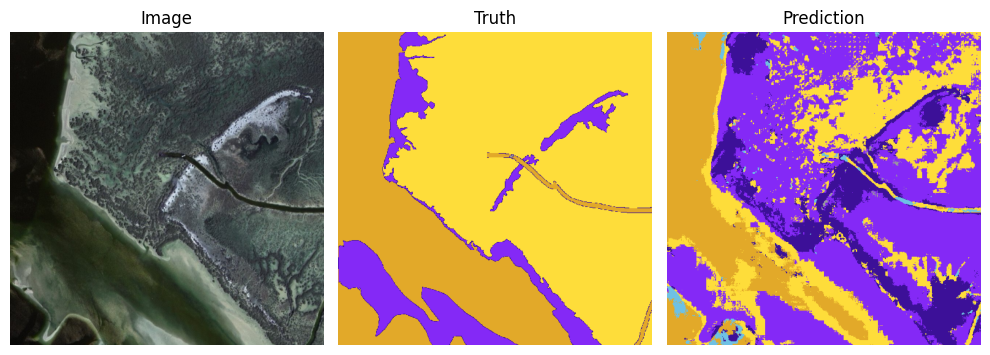

Accuracy: 0.4106 | Loss: 0.5855
IOU... building: 0.04 land: 0.19 vegetation: 0.22 water: 0.57 unlabeled: 0.00 




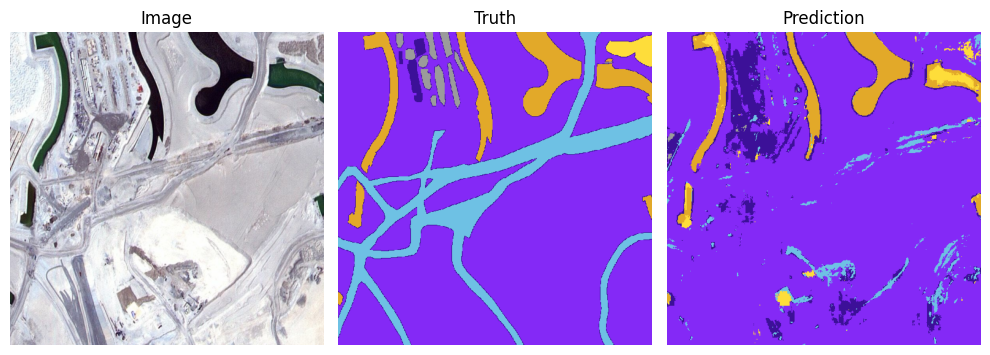

Accuracy: 0.7535 | Loss: 0.6254
IOU... building: 0.12 land: 0.76 road: 0.06 vegetation: 0.09 water: 0.78 unlabeled: 0.01 




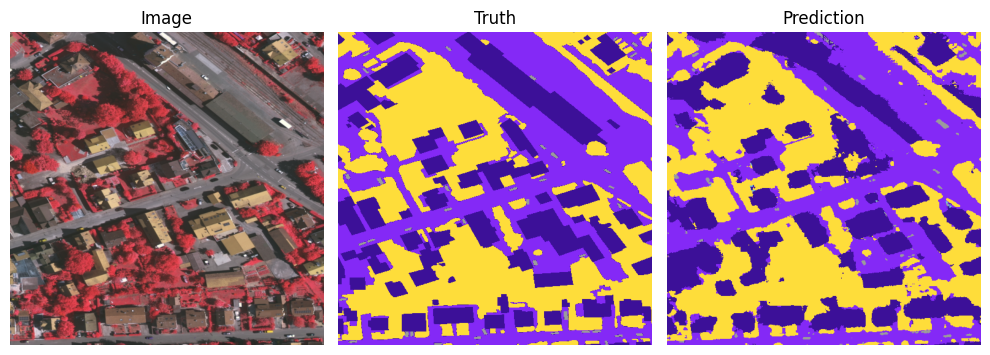

Accuracy: 0.8382 | Loss: 0.1711
IOU... building: 0.64 land: 0.69 vegetation: 0.83 unlabeled: 0.31 




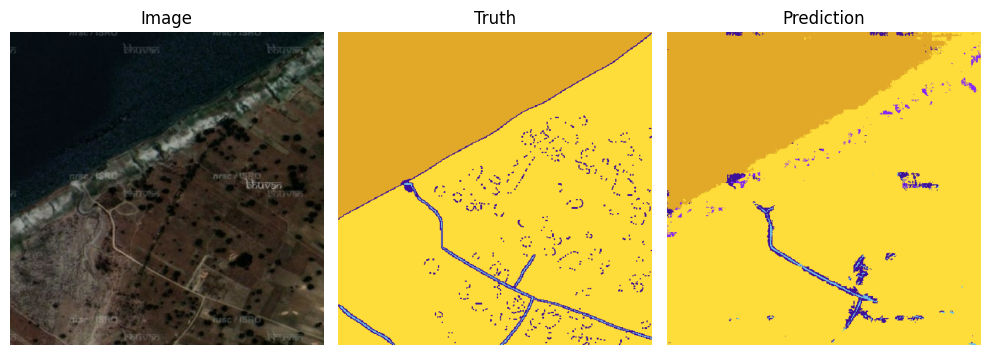

Accuracy: 0.9289 | Loss: 0.2612
IOU... building: 0.09 road: 0.22 vegetation: 0.91 water: 0.92 




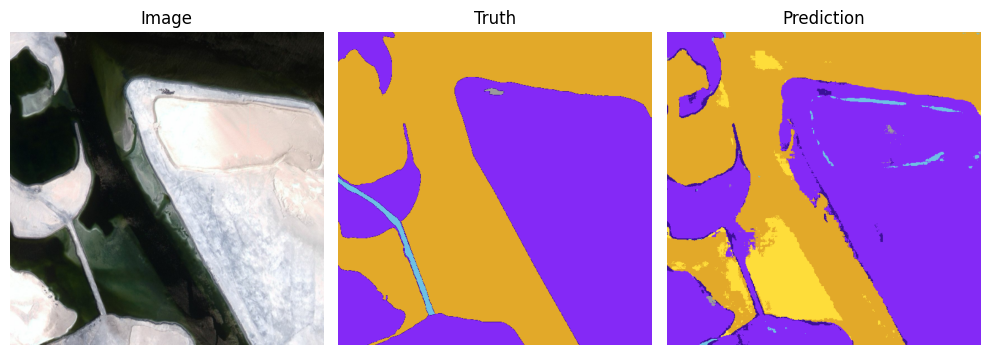

Accuracy: 0.8649 | Loss: 0.4972
IOU... building: 0.11 land: 0.90 water: 0.78 




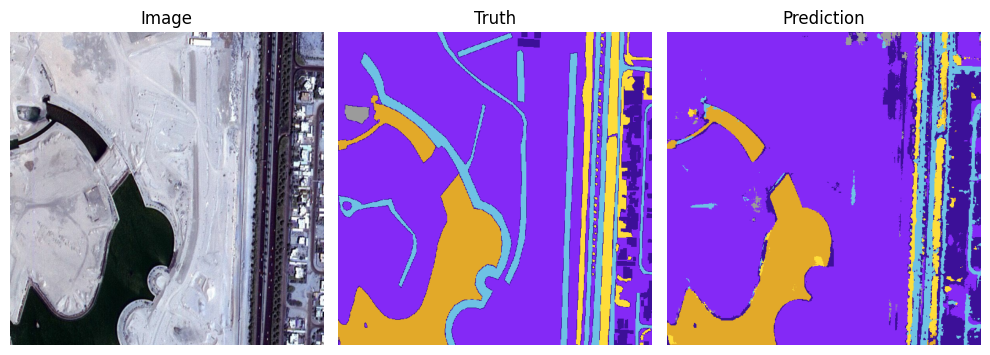

Accuracy: 0.7837 | Loss: 0.4454
IOU... building: 0.28 land: 0.78 road: 0.29 vegetation: 0.42 water: 0.92 unlabeled: 0.01 




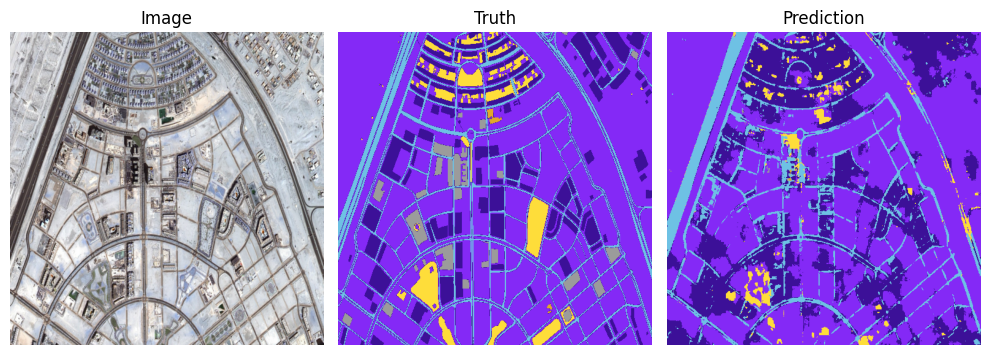

Accuracy: 0.7136 | Loss: 0.6081
IOU... building: 0.37 land: 0.71 road: 0.45 vegetation: 0.21 unlabeled: 0.00 




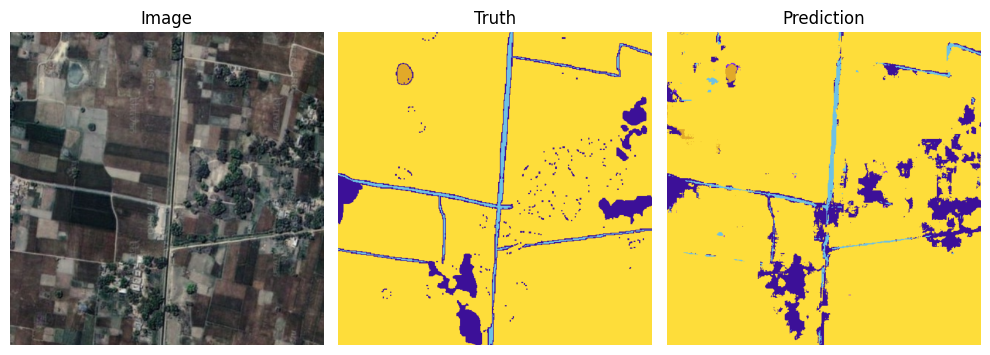

Accuracy: 0.9182 | Loss: 0.2290
IOU... building: 0.33 road: 0.44 vegetation: 0.92 water: 0.41 




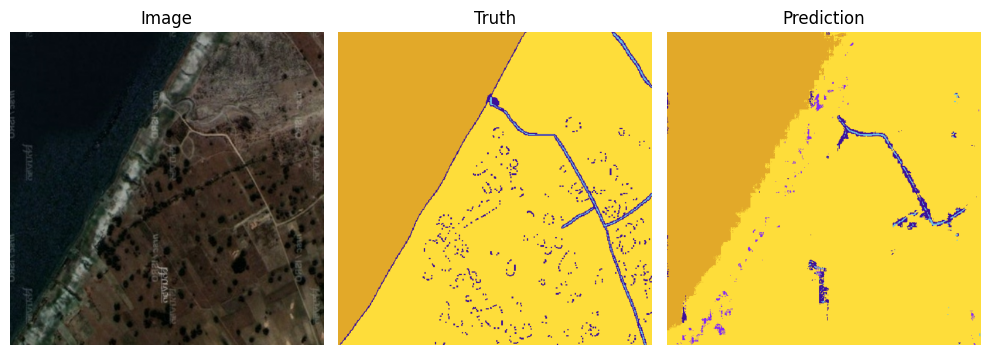

Accuracy: 0.9255 | Loss: 0.2672
IOU... building: 0.09 road: 0.21 vegetation: 0.90 water: 0.90 




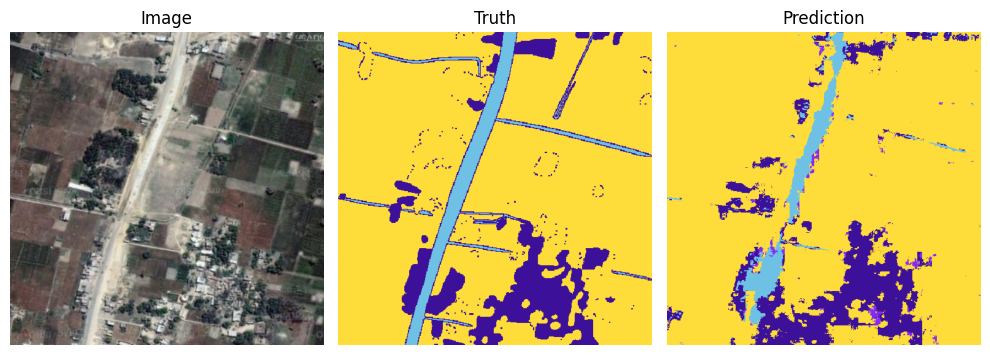

Accuracy: 0.8592 | Loss: 0.1672
IOU... building: 0.47 road: 0.28 vegetation: 0.86 




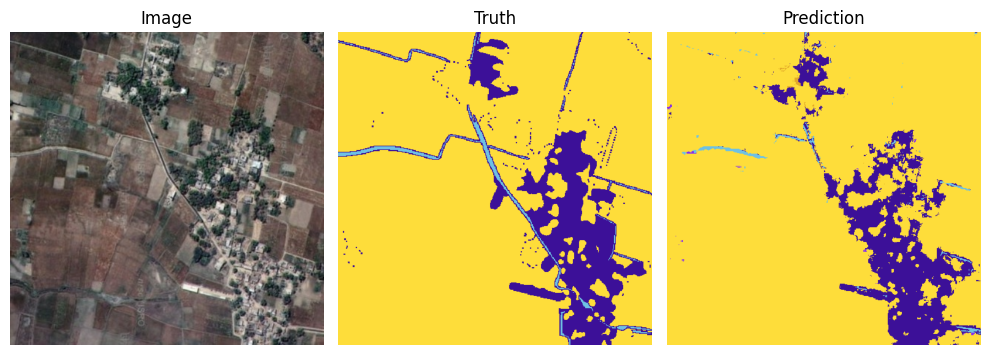

Accuracy: 0.9173 | Loss: 0.1600
IOU... building: 0.56 road: 0.22 vegetation: 0.92 




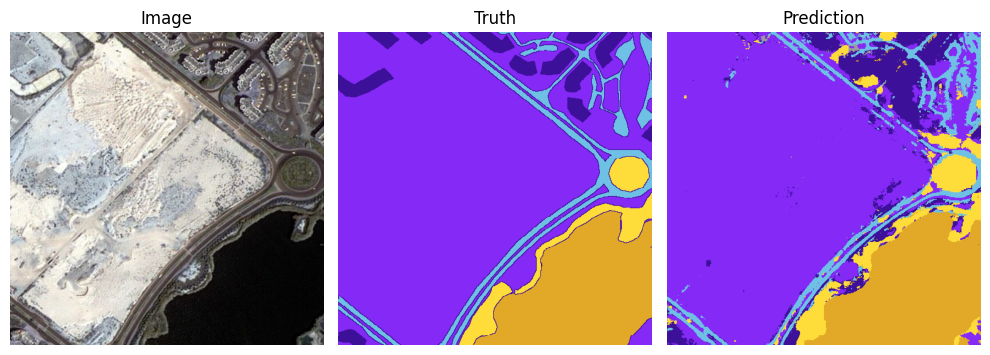

Accuracy: 0.8525 | Loss: 0.2219
IOU... building: 0.32 land: 0.84 road: 0.48 vegetation: 0.48 water: 0.96 




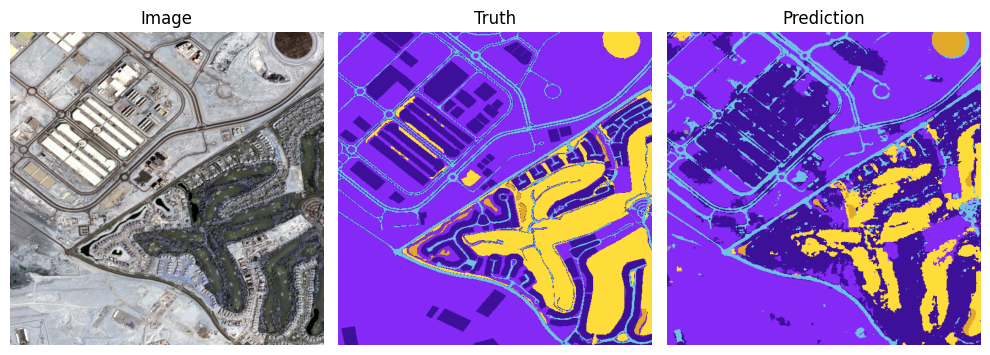

Accuracy: 0.7259 | Loss: 0.3156
IOU... building: 0.43 land: 0.72 road: 0.42 vegetation: 0.54 water: 0.23 




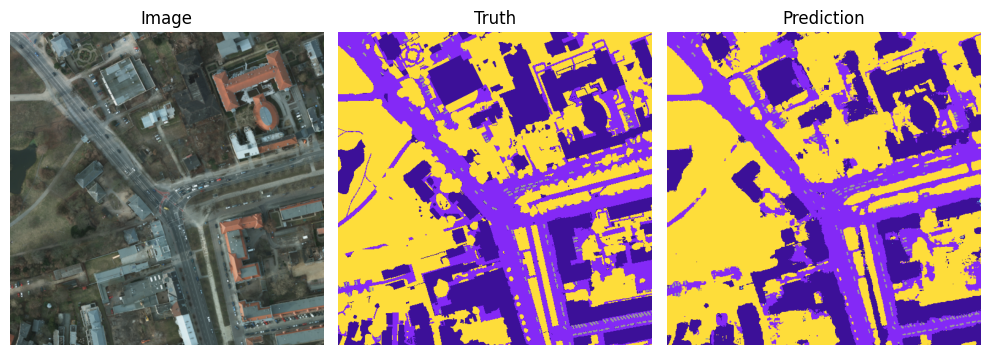

Accuracy: 0.8344 | Loss: 0.1335
IOU... building: 0.68 land: 0.64 vegetation: 0.79 water: 1.00 unlabeled: 0.58 




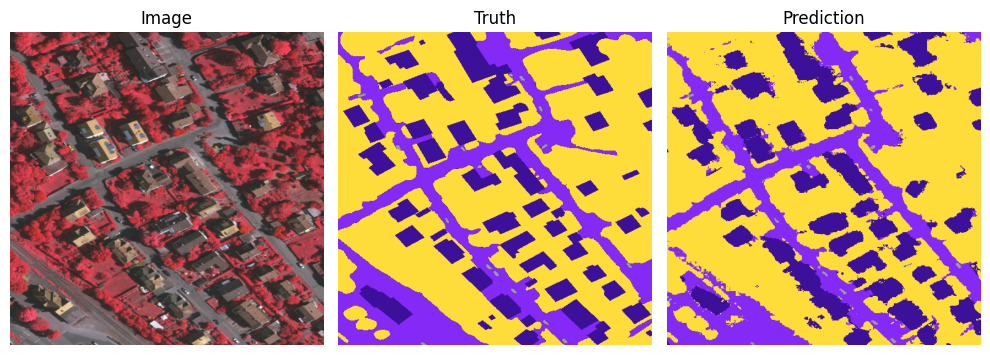

Accuracy: 0.8845 | Loss: 0.1187
IOU... building: 0.71 land: 0.72 vegetation: 0.85 water: 1.00 unlabeled: 0.54 




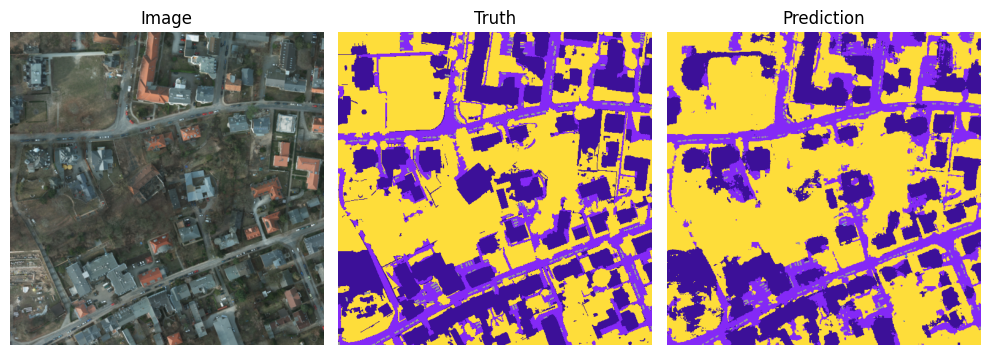

Accuracy: 0.8233 | Loss: 0.1631
IOU... building: 0.67 land: 0.53 vegetation: 0.80 unlabeled: 0.47 




In [15]:
test_acc_list = []
iou_list = torch.tensor([])
count = 0

with torch.no_grad():
    for x, y in test_loader:
        x, y = x.to(device), y.to(device) # y: (b, h, w)
        y_pred = model(x) # y_pred: (b, 6, h, w)

        loss = criterion(y_pred, y)

        # compute accuracy 
        acc = compute_accuracy(y, y_pred, device)
        test_acc_list.append(acc.item())

        # compute iou scores 
        y_pred_argmax = torch.argmax(y_pred, 1)
        tp, fp, fn, tn = get_stats(y_pred_argmax, y, mode='multiclass', num_classes=6)
        iou = iou_score(tp, fp, fn, tn)
        iou_list = torch.cat((iou_list, iou))

        # print predicted images
        y_imgs = class_index_to_image(y, dataset.color_map, device)
        pred_imgs = one_hot_to_image(y_pred, dataset.color_map, device)
        plot_prediction(x, y_imgs, pred_imgs, dataset.color_map, dataset.mask_labels)

        count += 1

        print(f'Accuracy: {acc:.4f} | Loss: {loss:.4f}')
        print_iou(iou[0], dataset.mask_labels)
        print('\n')

In [16]:
mean_test_acc = np.mean(test_acc_list)
print(f'The mean test set accuracy is {mean_test_acc:.4f}')

The mean test set accuracy is 0.7964


In [85]:
iou_scores = get_iou_by_class(iou_list, avg=True)
print_iou(iou_scores, dataset.mask_labels)

mean_iou_scores = np.mean(iou_scores)
print(f'Mean IOU: {mean_iou_scores}')

IOU... building: 0.44 land: 0.62 road: 0.28 vegetation: 0.63 water: 0.77 unlabeled: 0.34 
Mean IOU: 0.5145893692970276


In [22]:
checkpoint = {
    'epoch': epoch,
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'train_loss_list': loss_list,
    'train_acc_list': acc_list,
    'test_acc': mean_test_acc,
    'test_iou_scores': iou_scores
}

In [19]:
torch.save(checkpoint, 'res_unet_a/res_unet_a_50ep_checkpoint.pth')

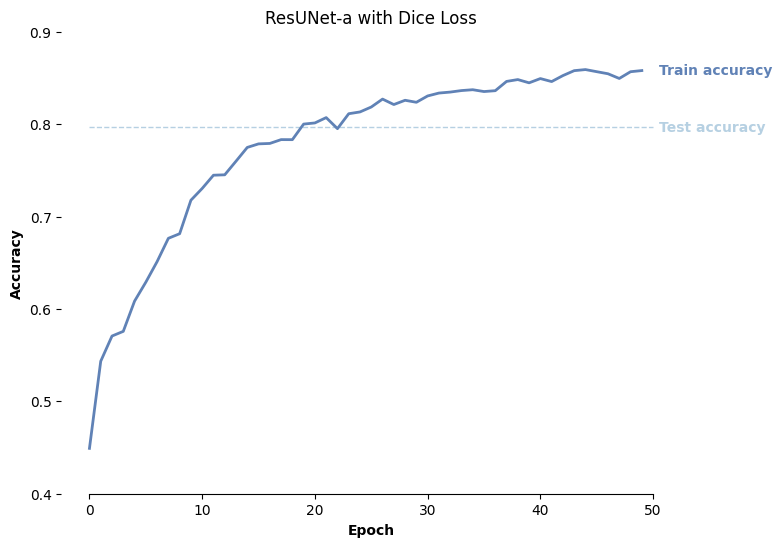

In [108]:
fig, ax = plt.subplots(figsize=(8, 6))

ax.plot(
    [0, EPOCHS], 
    [mean_test_acc, mean_test_acc],
    label="Test accuracy",
    color="#B6D0E2",
    linestyle="--",
    linewidth=1,
)

ax.text(
    EPOCHS * 1.01,
    mean_test_acc,
    "Test accuracy",
    color="#B6D0E2",
    fontweight="bold",
    horizontalalignment="left",
    verticalalignment="center",
)

ax.plot(
    acc_list,
    label="Train accuracy",
    color="#6082B6",
    linewidth=2,
)

ax.text(
    EPOCHS * 1.01,
    acc_list[-1],
    "Train accuracy",
    color="#6082B6",
    fontweight="bold",
    horizontalalignment="left",
    verticalalignment="center",
)

ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["top"].set_visible(False)

ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")
ax.spines["bottom"].set_bounds(0, EPOCHS)

ax.set_xticks(np.arange(0, EPOCHS + 1, 10))
ax.set_yticks(np.arange(0.4, 1.0, 0.1))

ax.set_xlabel("Epoch", fontweight="bold")
ax.set_ylabel("Accuracy", fontweight="bold")

plt.title('ResUNet-a with Dice Loss')
plt.show()

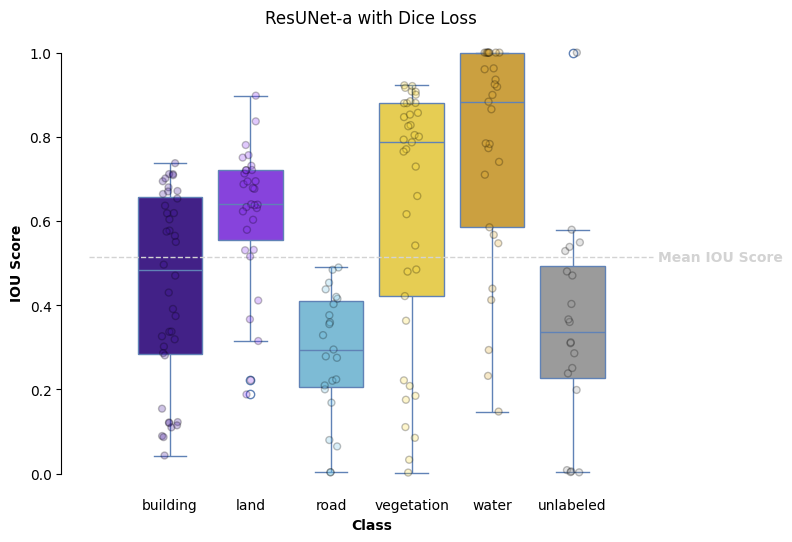

In [106]:
iou_scores = get_iou_by_class(iou_list)
iou_scores = [row.tolist() for row in iou_scores]

fig, ax = plt.subplots(figsize=(8, 6))

sns.boxplot(
    iou_scores,
    palette=['#3C1098', '#8429F6', '#6EC1E4', '#FEDD3A', '#E2A929', '#9B9B9B'],
    ax=ax,
    linecolor='#6082B6'
)
sns.stripplot(
    iou_scores,
    palette=['#3C1098', '#8429F6', '#6EC1E4', '#FEDD3A', '#E2A929', '#9B9B9B'],
    ax=ax,
    alpha=0.25,
    edgecolor='black',
    linewidth=1,
    jitter=True
)
ax.plot(
    [-1, 6], 
    [mean_iou_scores, mean_iou_scores],
    label="Test accuracy",
    color="lightgray",
    linestyle="--",
    linewidth=1,
)
ax.text(
    6 * 1.01,
    mean_iou_scores,
    "Mean IOU Score",
    color="lightgray",
    fontweight="bold",
    horizontalalignment="left",
    verticalalignment="center",
)

ax.set_xticks(range(dataset.num_classes), dataset.mask_labels)
ax.tick_params(axis='x', length=0)

ax.spines["right"].set_visible(False)
ax.spines["bottom"].set_visible(False)
ax.spines["top"].set_visible(False)
ax.spines["left"].set_bounds(0, 1)

ax.set_xlabel('Class', fontweight="bold")
ax.set_ylabel('IOU Score', fontweight="bold")

plt.title('ResUNet-a with Dice Loss')
plt.show()